In [2]:
import torch
import pandas
import matplotlib.pyplot as plt
import cv2

In [9]:
df = pandas.read_csv('./17_03_23/alturas.csv')
df

,col1,col2,col3,col4,col5,col6
row1,0.00,58.89,79.88,79.35,47.04,72.77
row2,62.63,85.58,88.74,97.62,79.39,72.88
row3,84.69,66.68,108.55,105.31,98.82,-1.00
row4,92.31,97.76,96.18,88.49,101.04,-1.00
row5,56.81,-1.00,93.75,-1.00,94.52,-1.00
row6,54.09,78.74,-1.00,92.55,84.26,-1.00
row7,77.09,86.95,-1.00,-1.00,-1.00,-1.00
row8,-1.00,-1.00,57.30,65.65,72.33,-1.00
row9,96.30,83.14,90.51,86.52,-1.00,-1.00
row10,-1.00,108.92,81.87,91.07,73.99,-1.00


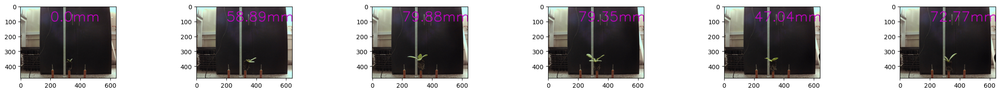

In [34]:
import os

def plot_tray(cols, rows, path, color_text, thick_text):

    break_condition = 5

    col = range(1,cols + 1)
    row = range(1,rows + 1)


    fig = plt.figure(figsize=(30, 30))

    idx = 0
    for i in col:
        for j in row:
            idx = idx + 1

            file = f"seedlings_{j}_{i}.jpg"
            vertical_seedling = plt.imread(os.path.join(path,file))
            max_leaf = df[f"col{i}"][f"row{j}"]
            
            s = f"{max_leaf}mm"
            font = cv2.FONT_HERSHEY_SIMPLEX
            org = (200, 100)
            fontScale = 3
            color = color_text
            thickness = thick_text
            vertical_seedling = cv2.putText(vertical_seedling, s, org, font, 
                                            fontScale, color, thickness, cv2.LINE_AA)
            
            fig.add_subplot(12, 6, idx)
            plt.imshow(vertical_seedling)

    plt.show()

plot_tray(cols=6, rows=1, path='./17_03_23/horizontal/rgb', color_text = (200, 0, 200), thick_text=3)

In [37]:
import sys
sys.path.insert(1, '/home/pqbas/projects/LABINM_Robotics_Automation/SeedlingsNet/detectors')
sys.path.insert(2, '/home/pqbas/projects/LABINM_Robotics_Automation/SeedlingsNet/detectors/yolov7')
sys.path.insert(3, '/home/pqbas/projects/LABINM_Robotics_Automation/SeedlingsNet')

from detector import Detector
detector_v = Detector('yolo7', weights='/home/pqbas/projects/LABINM_Robotics_Automation/SeedlingsNet/detectors/weights/yolov7-hseed.pt', data='./weights/opt.yaml', device='cuda:0')  # eg: 'yolov7' 'maskrcnn'

YOLOv5 🚀 2023-2-13 Python-3.8.16 torch-1.13.1 CUDA:0 (NVIDIA GeForce RTX 2070 with Max-Q Design, 7974MiB)

YOLOv5 🚀 2023-2-13 Python-3.8.16 torch-1.13.1 CUDA:0 (NVIDIA GeForce RTX 2070 with Max-Q Design, 7974MiB)



Detector in building............!!!


Fusing layers... 
Fusing layers... 
yolov7-seg summary: 325 layers, 37842476 parameters, 0 gradients, 141.9 GFLOPs
yolov7-seg summary: 325 layers, 37842476 parameters, 0 gradients, 141.9 GFLOPs


In [85]:
import numpy as np

def get_bbox_from_mask(mask):

    seg_value = 1

    if mask is not None:
        np_seg = np.array(mask)
        segmentation = np.where(np_seg == seg_value)

        # Bounding Box
        bbox = 0, 0, 0, 0
        if len(segmentation) != 0 and len(segmentation[1]) != 0 and len(segmentation[0]) != 0:
            x_min = int(np.min(segmentation[1]))
            x_max = int(np.max(segmentation[1]))
            y_min = int(np.min(segmentation[0]))
            y_max = int(np.max(segmentation[0]))
            bbox = x_min, y_min, x_max, y_max
            return bbox
        
        return None
    else:
        # Handle error case where segmentation image cannot be read or is empty
        print("Error: Segmentation image could not be read or is empty.")
        return None


def get_data_from_gallery(path):

    mask = plt.imread(path)

    x_min, y_min, x_max, y_max = get_bbox_from_mask(mask)

    height = y_max - y_min
    width = x_max - x_min
    area = cv2.countNonZero(mask)

    return {
        'heigth':height,
        'width':width,
        'area':area
    }

183 167 11287


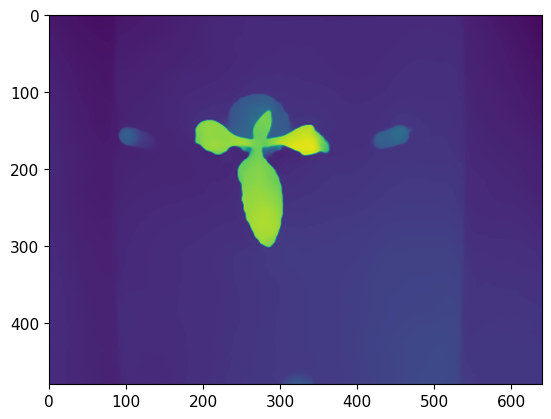

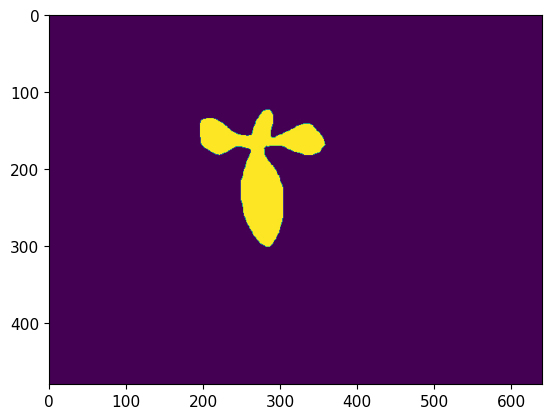

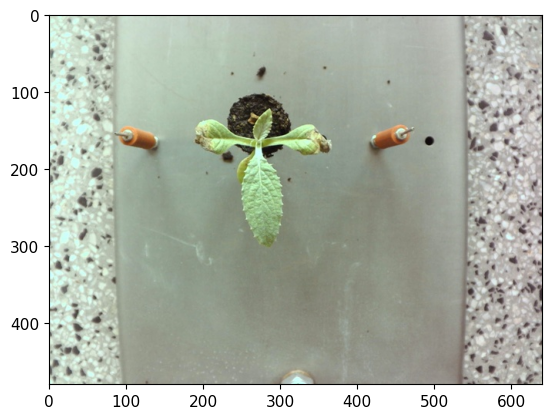

In [83]:
%matplotlib inline
from process import applyDepthOverImage
import numpy as np

type = 'vertical'
img = plt.imread(f"./24_03_23/{type}/rgb/seedlings_{1}_{5}.jpg")
depth = plt.imread(f"./24_03_23/{type}/depth/seedlings_{1}_{5}.jpg")
mask = plt.imread(f"./24_03_23/{type}/mask/seedlings_mask_{1}_{5}.jpg")

x_min, y_min, x_max, y_max = get_bbox_from_mask(mask)

vertical_height = y_max - y_min
vertical_width = x_max - x_min
vertical_area = cv2.countNonZero(mask)

print(vertical_height, vertical_width, vertical_area)

plt.imshow(depth)
plt.show()
plt.imshow(mask)
plt.show()
plt.imshow(img)
plt.show()


In [90]:
dataset = {
    'vertical': [],
    'horizontal': [],
    'quality': []
}

path = f"./24_03_23/vertical/mask/seedlings_mask_{1}_{5}.jpg"
data = get_data_from_gallery(path)

path = f"./24_03_23/vertical/mask/seedlings_mask_{1}_{5}.jpg"
data = get_data_from_gallery(path)

print(data)

{'heigth': 183, 'width': 167, 'area': 11287}


In [ ]:
ret, thresh1 = cv2.threshold(depth, 120, 255, cv2.THRESH_BINARY)
result = cv2.bitwise_and(img,img,mask = thresh1)
img_pred = detector_v.predict(result)

H, W, C = img.shape

x1,y1,x2,y2 = img_pred[0].bbox
fig, axs = plt.subplots(1, 3, figsize=(10, 10))

for idx, img_ in enumerate([img, img_pred[0].mask]):
    start_point = (int(x1), int(y1))
    end_point = (int(x2), int(y2))
    thickness = 2
    #img_ = cv2.rectangle(img_, start_point, end_point, color = (1,0,0), thickness=2)
    axs[idx].imshow(img_)

x = ["area", "height", "width"]
y = [img_pred[0].area/(H*W), (y2-y1)/H, (x2-x1)/W]
axs[2].bar(x, y)

plt.show()

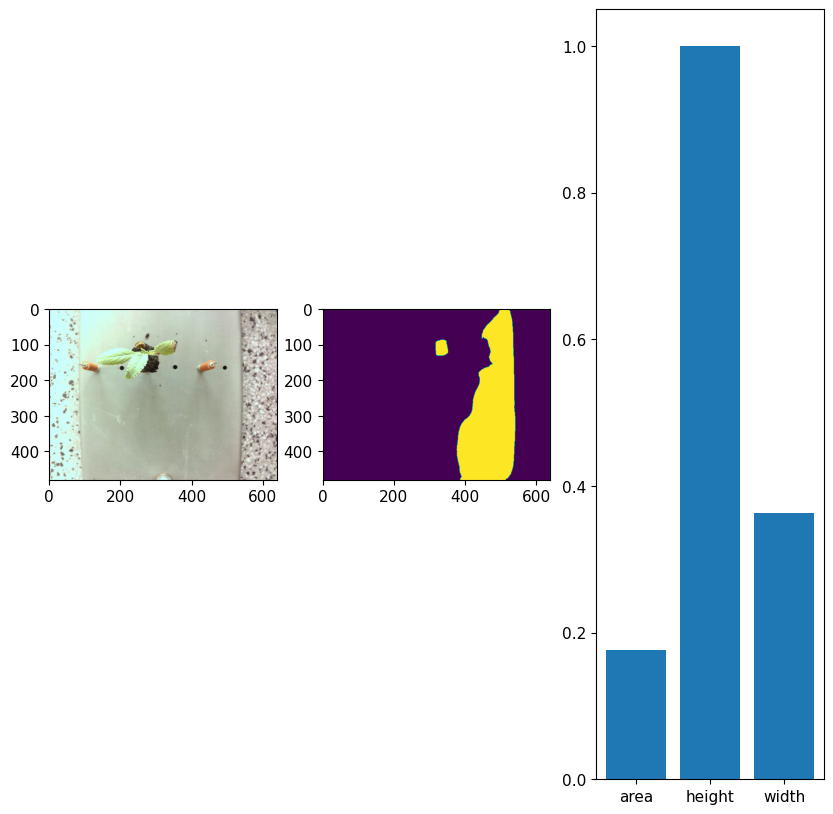

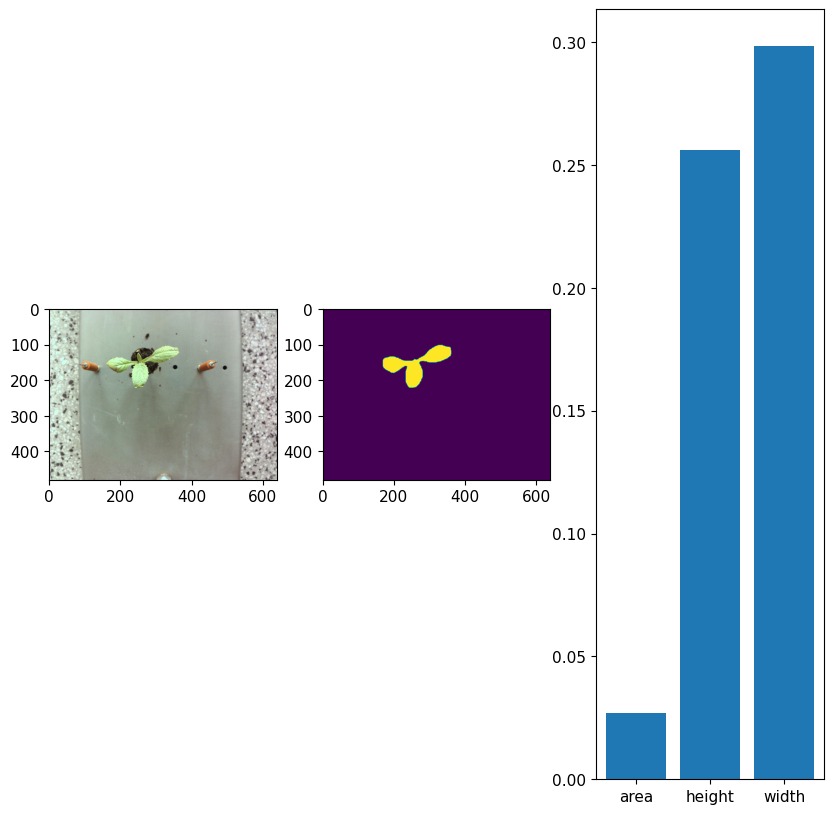

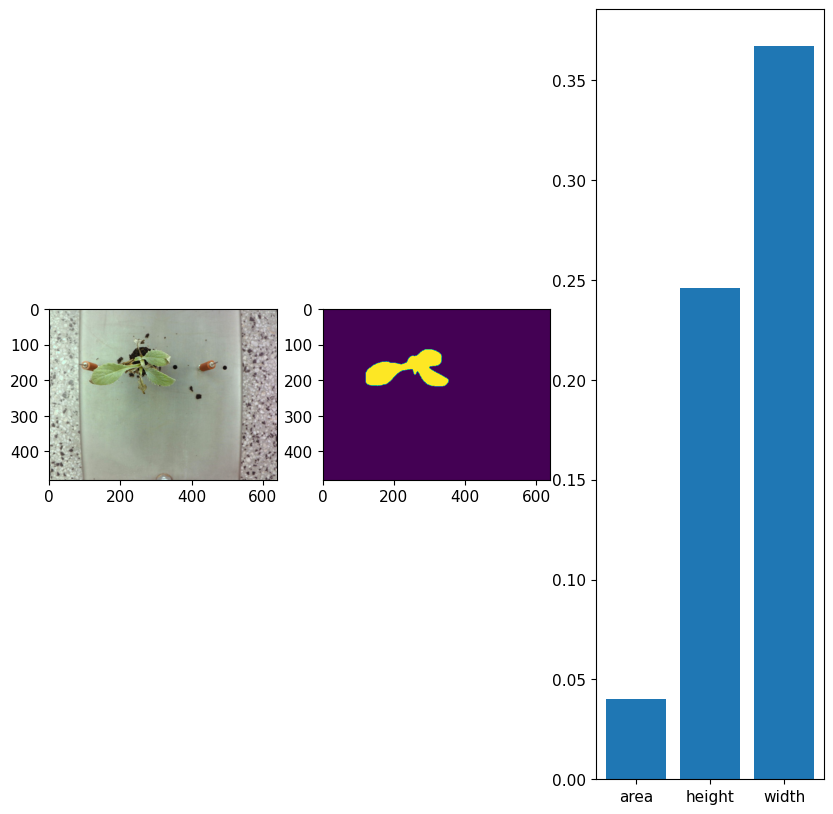

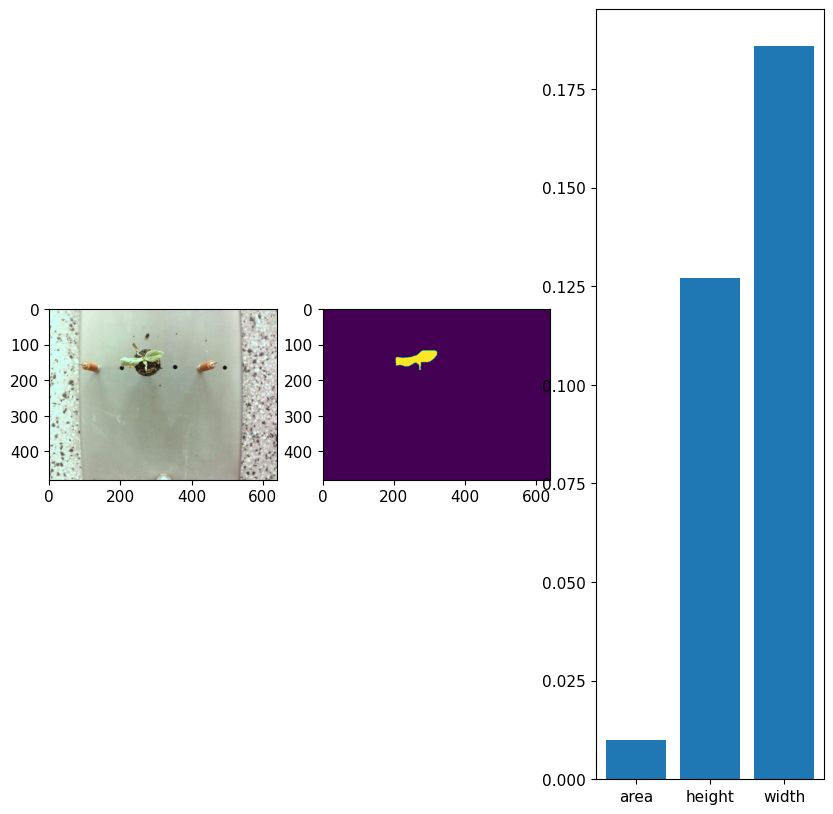

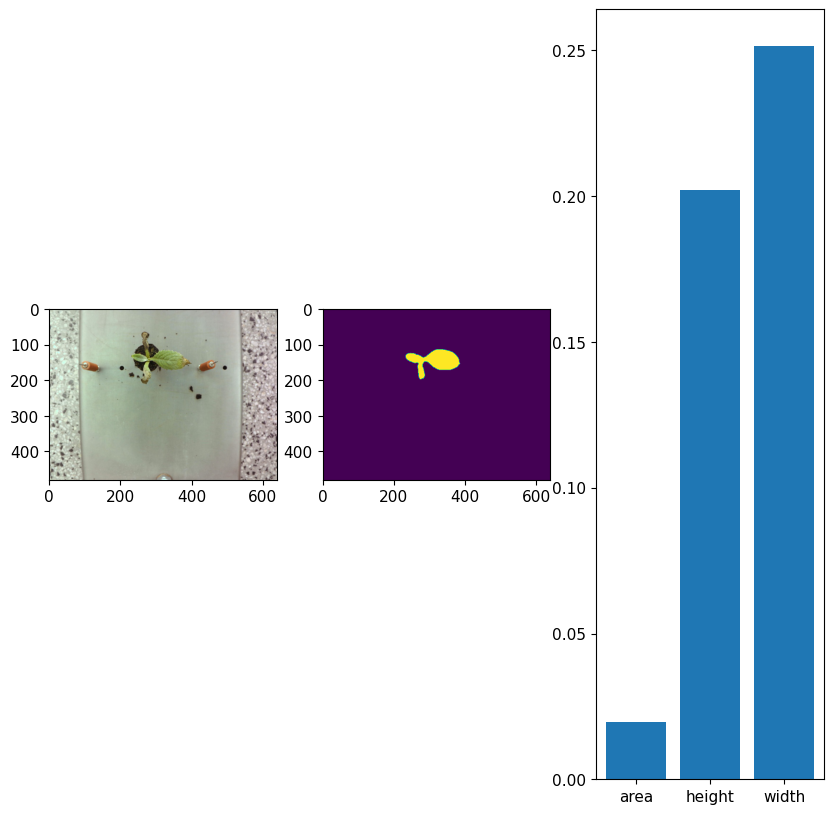

...

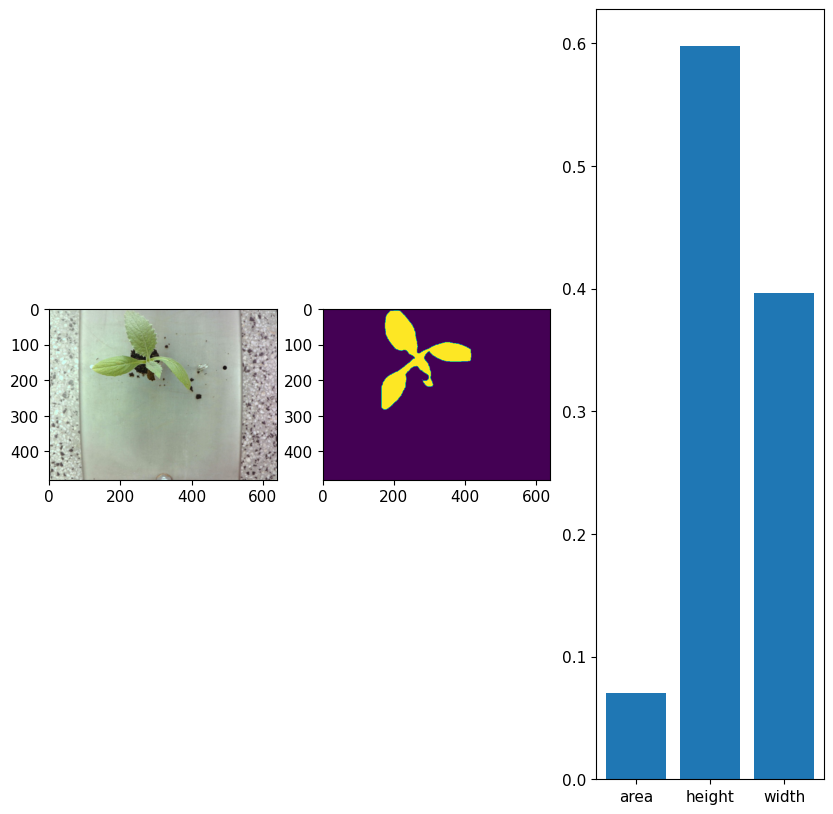

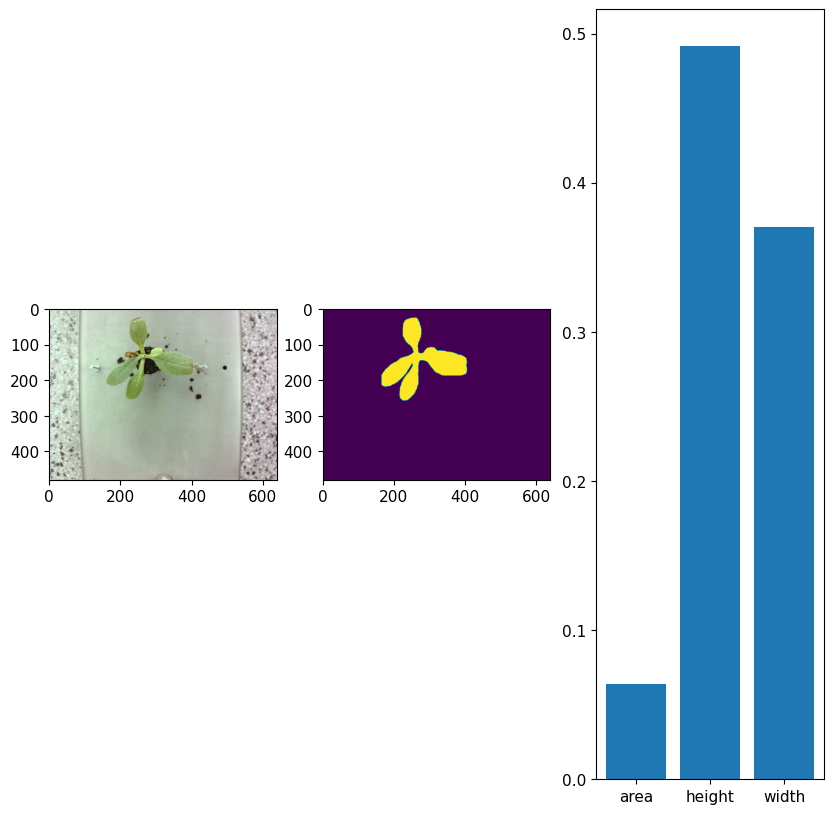

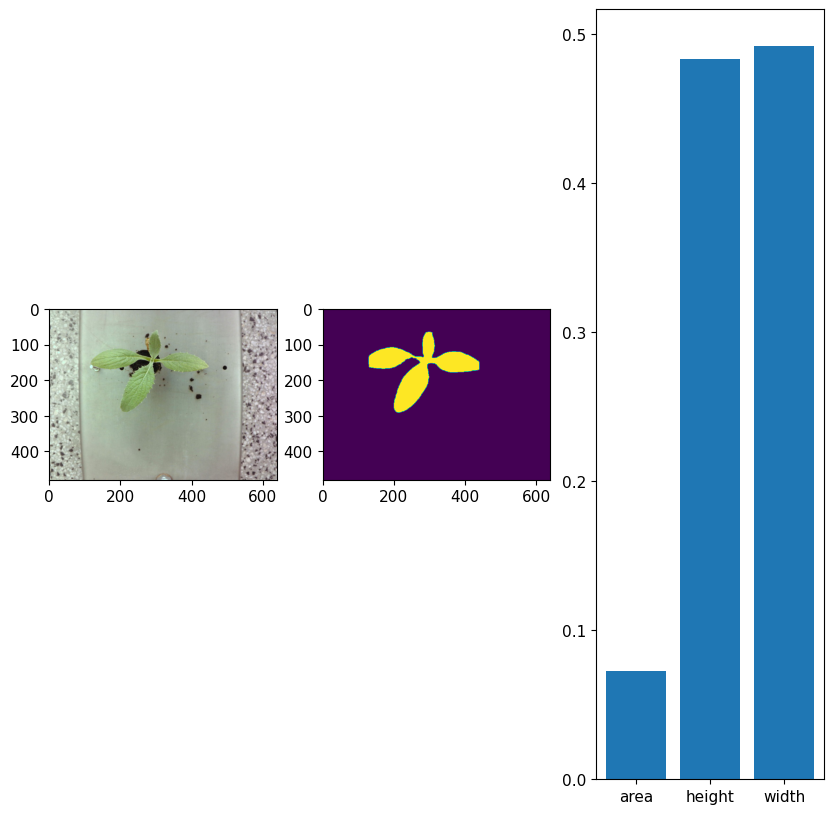

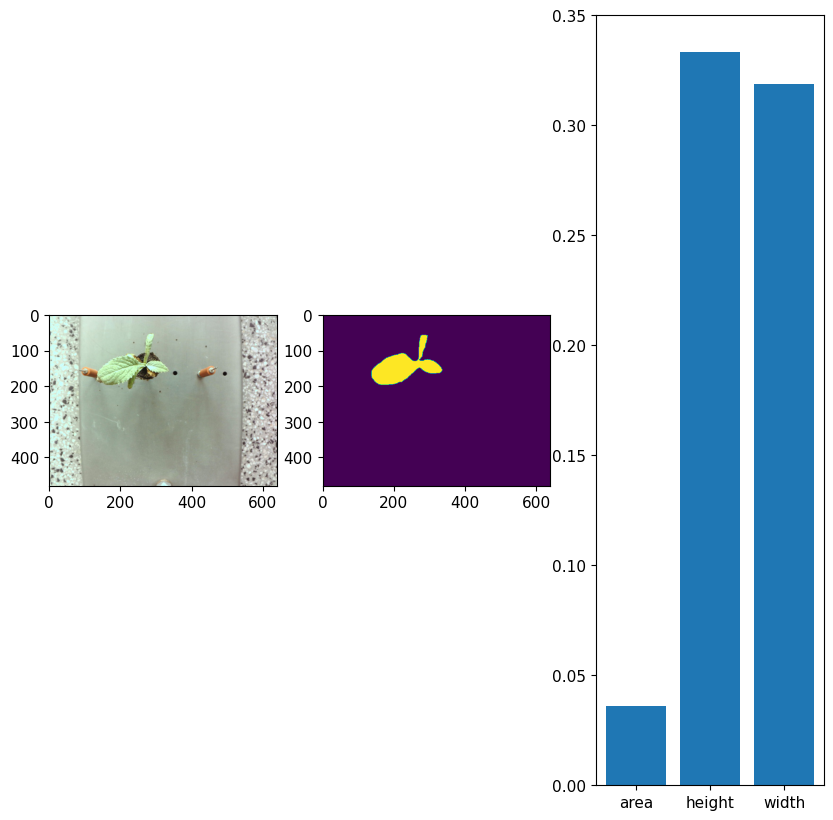

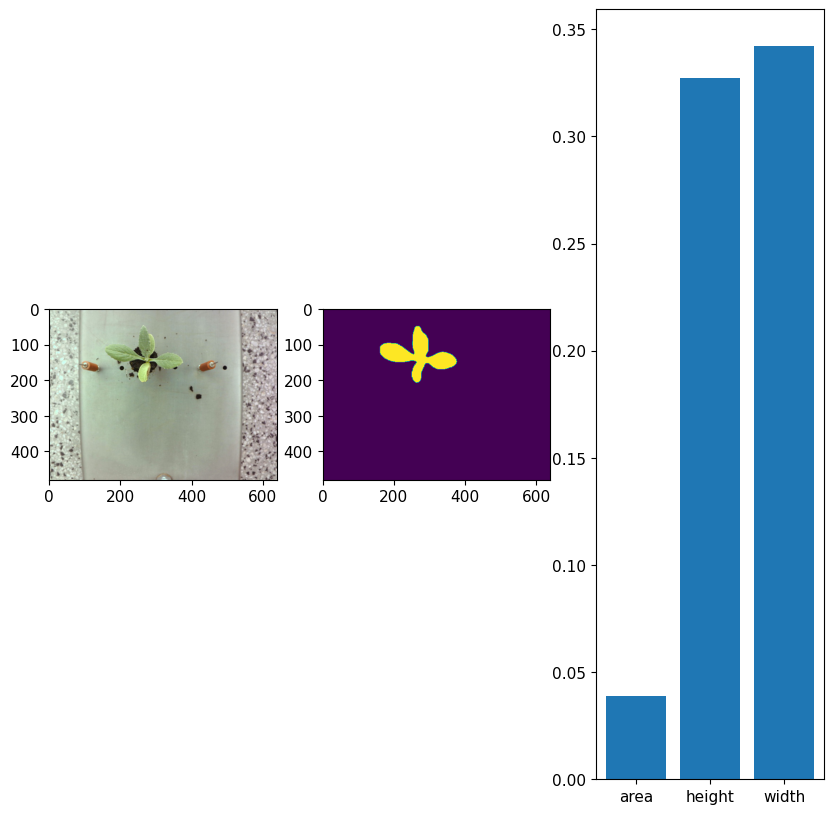

In [285]:
col = range(1,7)
row = range(1,13)

height1 = []
width1 = []
area1 = []
quality = []

idx = 0
for i in col:
    for j in row:

        # read the corresponding seedling and apply yolov7 to obtain their mask, area, bbox
        img = plt.imread(f"./data/gallery_24_03_23/vertical/rgb/seedlings_{j}_{i}.jpg")
        depth = plt.imread(f"./data/gallery_24_03_23/vertical/depth/seedlings_{j}_{i}.jpg")
        ret, thresh1 = cv2.threshold(depth, 120, 255, cv2.THRESH_BINARY)
        result = cv2.bitwise_and(img,img,mask = thresh1)
        img_pred = detector_v.predict(result)


        # assign a quality according the long of the max leaf
        max_leaf = df[f"col{i}"][f"row{j}"]
        if max_leaf == -1:
            break
        elif max_leaf > 80 :
            quality_status = 1
        else:
            quality_status = 0

        # verify if the prediction was succesful
        if img_pred is None:
            break

        # get the height, width, area. Normalize them and save it in a list
        H, W, C = img.shape
        x1,y1,x2,y2 = img_pred[0].bbox
        fig, axs = plt.subplots(1, 3, figsize=(10, 10))

        area_normalized = img_pred[0].area/(H*W)
        heigth_normalized = (y2-y1)/H
        width_normalized = (x2-x1)/W

        height1.append(heigth_normalized)
        width1.append(width_normalized)
        area1.append(area_normalized)
        quality.append(quality_status)


        # plot the bbox and mask
        for idx, img_ in enumerate([img, img_pred[0].mask]):
            start_point = (int(x1), int(y1))
            end_point = (int(x2), int(y2))
            thickness = 2
            #img_ = cv2.rectangle(img_, start_point, end_point, color = (1,0,0), thickness=2)
            axs[idx].imshow(img_)

        x = ["area", "height", "width"]
        y = [area_normalized, heigth_normalized, width_normalized]
        axs[2].bar(x, y)


# build a dataframe with the data recolected
dataset = {
    'area': area1,
    'height': height1,
    'width': width1,
    'quality': quality
}

In [286]:
dataset_2 = pandas.DataFrame(dataset)
dataset_2

,area,height,width,quality
0,0.176842,1.000000,0.362500,0
1,0.027044,0.256250,0.298438,0
2,0.040387,0.245833,0.367188,1
3,0.009915,0.127083,0.185938,0
4,0.019743,0.202083,0.251563,1
5,0.013626,0.206250,0.151562,0
6,0.020794,0.343750,0.198437,0
7,0.043506,0.316667,0.365625,1
8,0.010645,0.156250,0.192188,1
9,0.012539,0.137500,0.154688,0


In [284]:
dataset_vertical = pandas.DataFrame(dataset)
dataset_vertical

,area,height,width,quality
0,0.006348,0.089583,0.096875,0
1,0.032640,0.281250,0.285938,0
2,0.045290,0.306250,0.289062,1
3,0.057835,0.302083,0.456250,1
4,0.029749,0.250000,0.300000,0
5,0.031536,0.285417,0.318750,0
6,0.042806,0.314583,0.343750,0
7,0.016748,0.160417,0.189062,0
8,0.050944,0.347917,0.512500,1
9,0.041032,0.277083,0.353125,0


## Building the dataset to classification

In [383]:
def getDataVerticalView(path, df):
    col = range(1,7)
    row = range(1,13)

    height1 = []
    width1 = []
    area1 = []
    quality = []

    fig = plt.figure(figsize=(30, 30))
    
    idx = 0
    for i in col:
        for j in row:

            # read the corresponding seedling and apply yolov7 to obtain their mask, area, bbox
            img = plt.imread(f"{path}/vertical/rgb/seedlings_{j}_{i}.jpg")
            H, W, C = img.shape
            depth = plt.imread(f"{path}/vertical/depth/seedlings_{j}_{i}.jpg")
            ret, thresh1 = cv2.threshold(depth, 120, 255, cv2.THRESH_BINARY)
            result = cv2.bitwise_and(img,img,mask = thresh1)
            img_pred = detector_v.predict(result)


            # assign a quality according the long of the max leaf
            max_leaf = df[f"col{i}"][f"row{j}"]
            if max_leaf == -1:
                continue
            elif max_leaf > 80 :
                quality_status = 1
            else:
                quality_status = 0

            # verify if the prediction was succesful
            if img_pred is None or len(img_pred) == 0:
                continue

            if img_pred[0].area/(H*W) > 0.14:
                continue

            # get the height, width, area. Normalize them and save it in a list
            x1,y1,x2,y2 = img_pred[0].bbox

            area_normalized = img_pred[0].area/(H*W)
            heigth_normalized = (y2-y1)/H
            width_normalized = (x2-x1)/W

            height1.append(heigth_normalized)
            width1.append(width_normalized)
            area1.append(area_normalized)
            quality.append(quality_status)

            # to plot something
            idx = idx + 1

            s = f"{max_leaf}mm"
            font = cv2.FONT_HERSHEY_SIMPLEX
            org = (200, 400)
            fontScale = 2
            color = (255, 0, 0)
            thickness = 2
            # img_pred[0].mask*255
            img = cv2.putText(img, s, org, font, 
                                            fontScale, color, thickness, cv2.LINE_AA)
            
            fig.add_subplot(12, 6, idx)
            plt.imshow(img)



    # build a dataframe with the data recolected
    dataset = {
        'area': area1,
        'height': height1,
        'width': width1,
        'quality': quality
    }

    return dataset

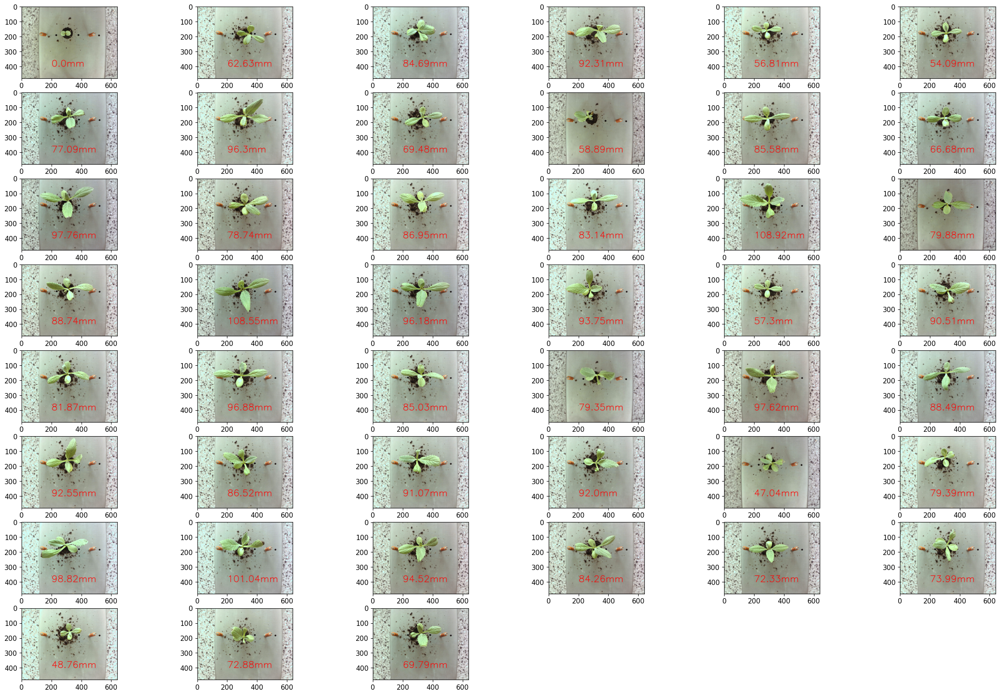

In [384]:
df = pandas.read_csv('./data/gallery_17_03_23/Plantines_17_03_23 - Sheet1.csv')
data_17_03_23 = pandas.DataFrame(getDataVerticalView('./data/gallery_17_03_23', df))


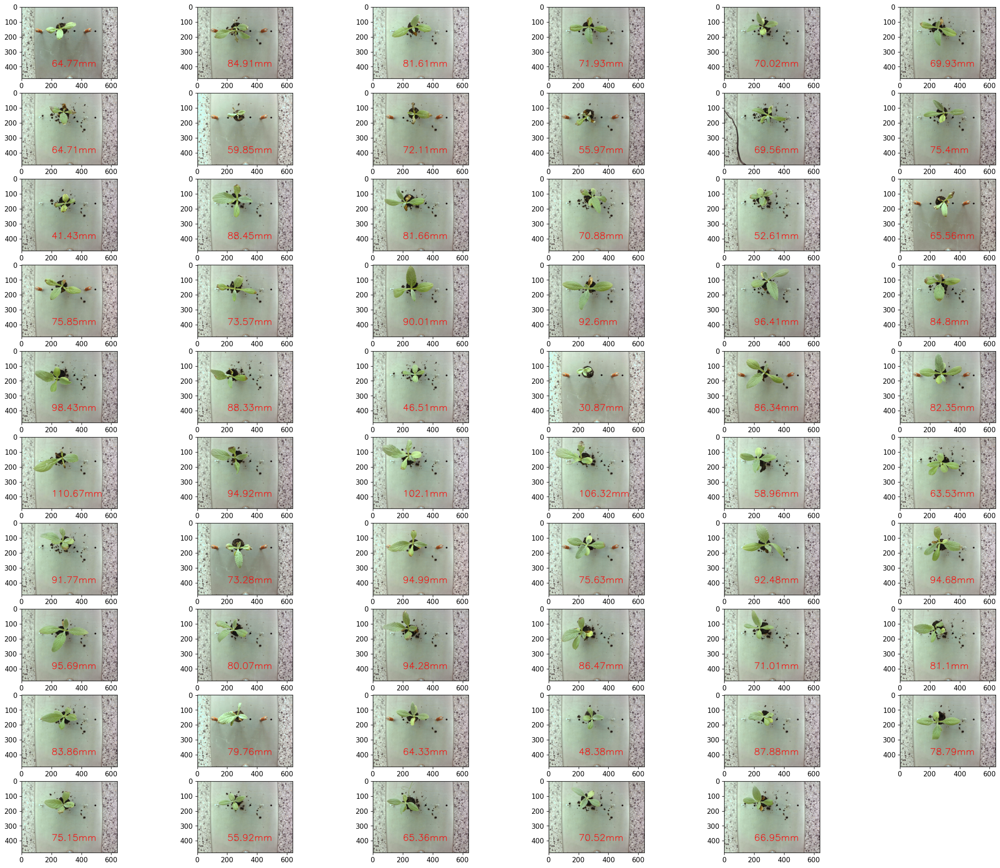

In [385]:
df = pandas.read_csv('./data/gallery_24_03_23/Plantines_24_03_23 - Sheet1.csv')
data_24_03_23 = pandas.DataFrame(getDataVerticalView('./data/gallery_24_03_23',df))

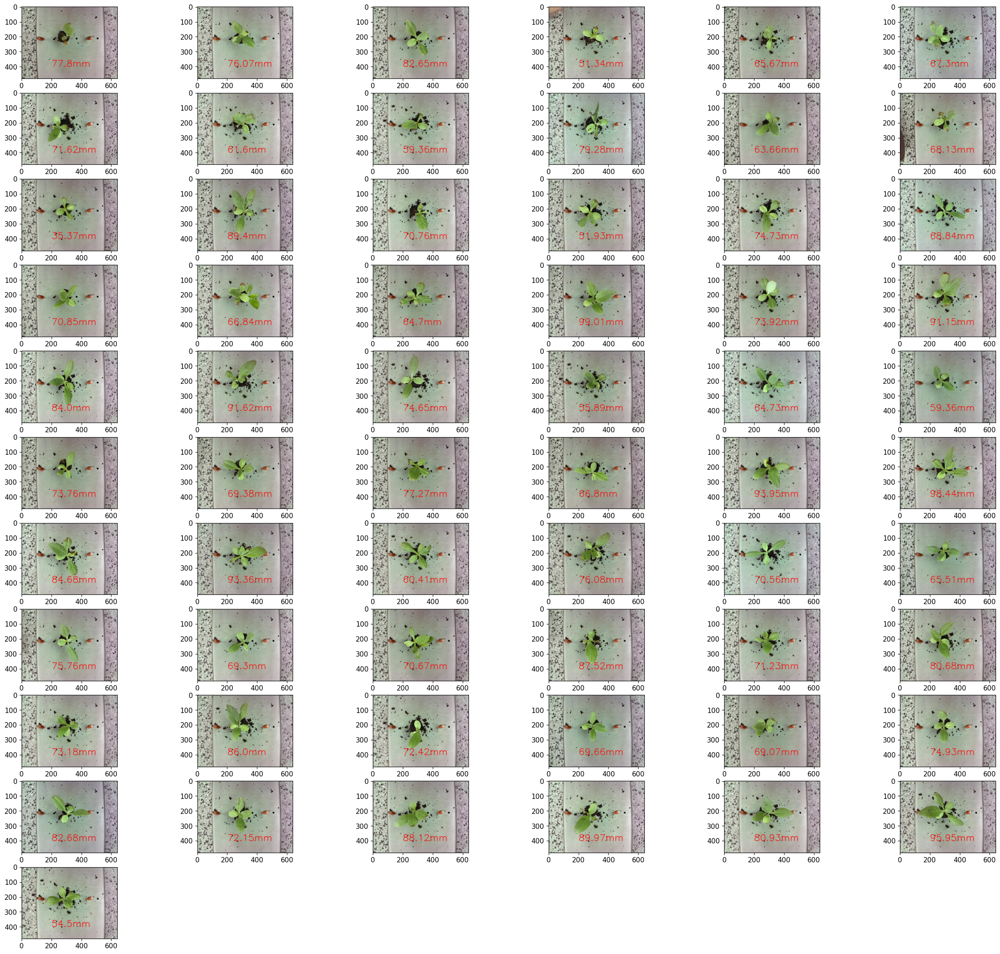

In [386]:
df = pandas.read_csv('./data/gallery_03_03_23_tray1/Plantines_03_02_23_tray1 - Hoja 1.csv')
data_03_03_23_tray1 = pandas.DataFrame(getDataVerticalView('./data/gallery_03_03_23_tray1',df))

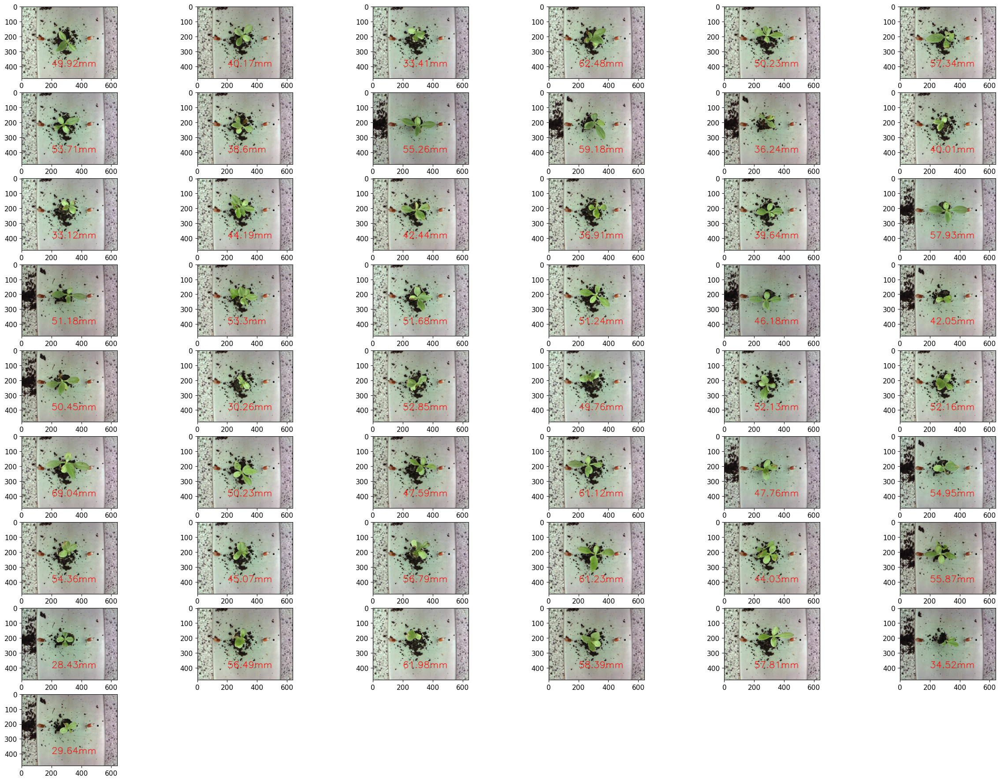

In [390]:
df = pandas.read_csv('./data/gallery_03_03_23_tray2/Plantines_03_02_23_tray2 - Hoja 1.csv')
data_03_03_23_tray2 = pandas.DataFrame(getDataVerticalView('./data/gallery_03_03_23_tray2',df))

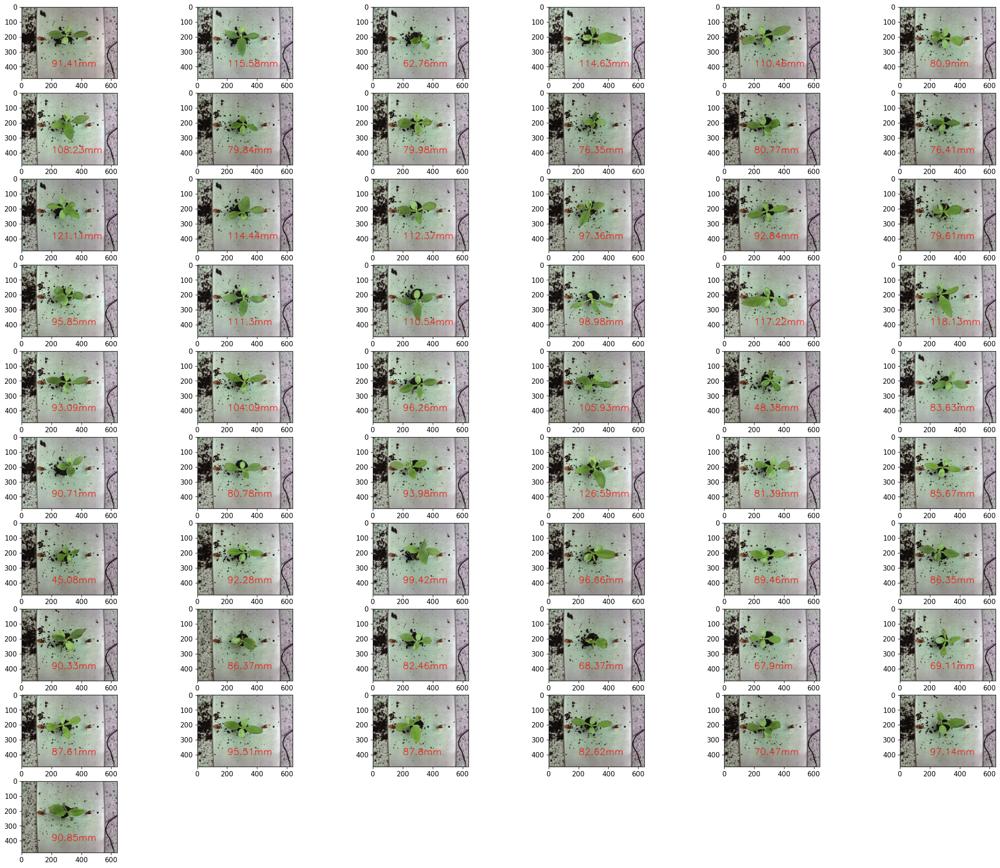

In [389]:
df = pandas.read_csv('./data/gallery_03_03_23_tray3/Plantines_03_02_23_tray3 - Hoja 1.csv')
data_03_03_23_tray3 = pandas.DataFrame(getDataVerticalView('./data/gallery_03_03_23_tray3',df))

In [399]:
combined_df = pandas.concat(
    [data_03_03_23_tray1, 
     data_03_03_23_tray2,
     data_03_03_23_tray3,
     data_17_03_23,
     data_24_03_23], axis=0)

combined_df.to_csv('combined_file.csv', index=False)

## Training a DeepLearning model

In [57]:
import torch
import pandas as pd
from torch.utils.data import Dataset, DataLoader
import numpy as np
from sklearn.model_selection import train_test_split
import copy


class seedlingFeaturesDataset(Dataset):
    def __init__(self, csv_file, root_dir):
            self.seedlingfeatures = pd.read_csv(csv_file)

    def __len__(self):
        return len(self.seedlingfeatures)
    

    def __getitem__(self, idx):

        if torch.is_tensor(idx):
            idx = idx.tolist()

        seedling_features = self.seedlingfeatures.iloc[idx, 0:3]
        quality = self.seedlingfeatures.iloc[idx, 3]

        seedling_features = np.array([seedling_features])
        quality = np.array([quality])

        sample = {'features':seedling_features, 'quality':quality}
        return sample
    
    def setSeedlingFeatures(self, idx):
        self.seedlingfeatures = self.seedlingfeatures.iloc[idx]
        return

    def get_subset(self, idx):
        dataset_copy = copy.copy(self)
        dataset_copy.setSeedlingFeatures(idx)
        return dataset_copy        


class DataloaderBuilder():
    def __init__(self, dataset):

        self.dataset = dataset
        self.len = len(dataset)
        self.range = range(0, self.len)

        self.input = None
        self.pred = None
    
    def get_train_test_set(self, test_size, batch_size=1):

        Xtrain_idx, Xtest_idx, Ytrain_idx, Ytest_idx = train_test_split(self.range, 
                                                        self.range, 
                                                        test_size=test_size, 
                                                        random_state=42,
                                                        shuffle=True)
        
        train_loader = DataLoader(self.dataset.get_subset(Xtrain_idx), batch_size=batch_size, shuffle=True)
        test_loader = DataLoader(self.dataset.get_subset(Xtest_idx), shuffle=True)
        return train_loader, test_loader


### Defining the ML-model and trainig loop

In [59]:
import torch.optim as optim
import torch
from torch import nn

def init_weights(m):
    if isinstance(m, nn.Linear):
        torch.nn.init.xavier_uniform(m.weight)
        m.bias.data.fill_(0.01)


class seedlingClassifier_MLP(nn.Module):
    def __init__(self,in_features):
        super().__init__()
        self.fc1 = nn.Linear(in_features, 32)
        self.fc2 = nn.Linear(32,64)
        self.fc3 = nn.Linear(64,32)
        self.fc4 = nn.Linear(32,1)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.relu(self.fc3(x))
        x = torch.sigmoid(self.fc4(x))
        return x


def train(model, dataloader, optimizer, criterion):
    for batch_idx, data in enumerate(dataloader):
        inputs = data['features'].type(torch.FloatTensor).squeeze()
        targets = data['quality'].type(torch.FloatTensor)

        outputs = model(inputs)

        #print(torch.cat((outputs,targets), dim=1))
        loss = criterion(outputs, targets)
        #acc = (outputs.reshape(-1).detach().numpy().round() == targets).mean()
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

### Training the MLP to classify the seedlings

In [60]:
seedling_dataset = seedlingFeaturesDataset(csv_file='combined_file.csv', root_dir='./')
ds = DataloaderBuilder(seedling_dataset)
trainloader, testloader = ds.get_train_test_set(
    test_size=0.3,
    batch_size=16
)

# Hyperparameters of training
learning_rate = 0.1
epochs = 700
running_loss = 0.0

# MLP model applied to classify the seedlings
model = seedlingClassifier_MLP(3)
model.apply(init_weights)
optimizer = torch.optim.SGD(model.parameters(),lr=learning_rate)
criterion = nn.BCELoss()

# training the MLP model
model.train()
for epoch in range(1000):
    train(model, trainloader, optimizer, criterion)

/tmp/ipykernel_16742/308527237.py:7: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  torch.nn.init.xavier_uniform(m.weight)


### Testing the MLP in test-set

In [72]:
# threshold of 40% gives the maximum precisionEntonces puedo concluir que el filtro de Kalman es un algoritmo que se usa en AI pero no es un algoritmo de AI
threshold = 0.4

correct = 0
fail = 0

# Testing on testset
with torch.no_grad():
    model.eval()    
    for data in testloader:
        input = data['features'].type(torch.FloatTensor).squeeze()
        target = data['quality'].type(torch.FloatTensor).squeeze(1)
        output = model(input)

        if output.item() > threshold:
            pred = 1
        else:
            pred = 0
        
        if pred == target:
            correct += 1
        else:
            fail += 1

print(correct/(correct+fail))

0.8518518518518519


# Horizontal View: Data processing - Visualization - ML Training / testing

In [1]:
%matplotlib inline
import sys
import matplotlib.pyplot as plt
import cv2

sys.path.insert(1, 'detectors')
sys.path.insert(2, 'detectors/yolov7')
from detector import Detector
detector_h = Detector('yolo7', weights='./weights/yolov7-hseed.pt', data='./weights/opt.yaml', device='cuda:0')  # eg: 'yolov7' 'maskrcnn'

Detector in building............!!!


YOLOv5 🚀 2023-2-13 Python-3.8.16 torch-1.13.1 CUDA:0 (NVIDIA GeForce RTX 2070 with Max-Q Design, 7974MiB)

YOLOv5 🚀 2023-2-13 Python-3.8.16 torch-1.13.1 CUDA:0 (NVIDIA GeForce RTX 2070 with Max-Q Design, 7974MiB)

Fusing layers... 
Fusing layers... 
yolov7-seg summary: 325 layers, 37842476 parameters, 0 gradients, 142.1 GFLOPs
yolov7-seg summary: 325 layers, 37842476 parameters, 0 gradients, 142.1 GFLOPs


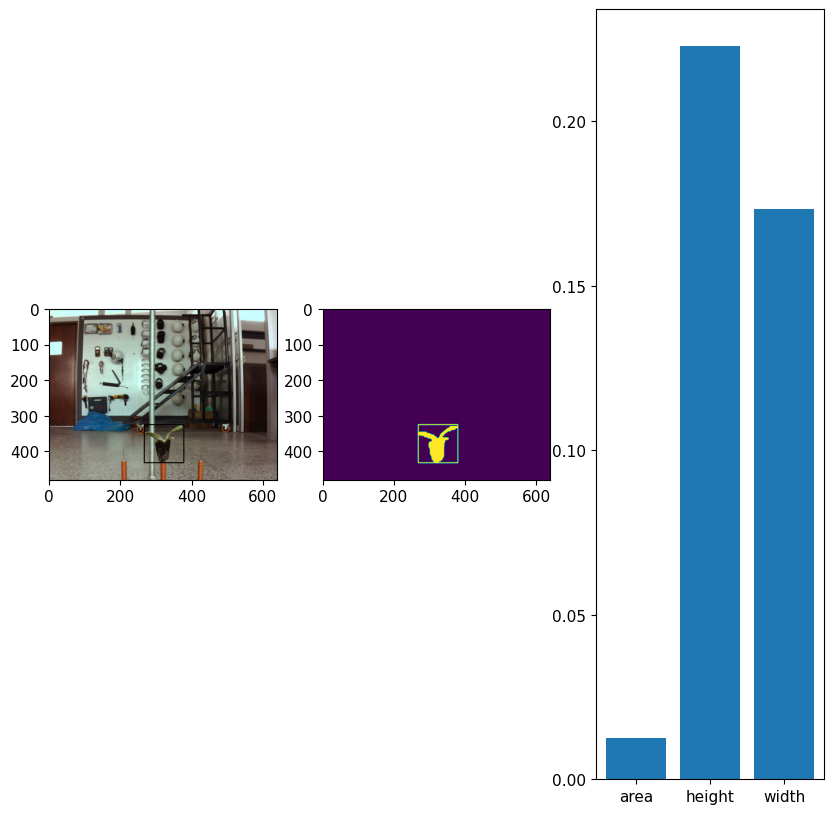

In [3]:
%matplotlib inline
img = plt.imread(f"./data/gallery_17_03_23/horizontal/rgb/seedlings_{8}_{4}.jpg")
img_pred = detector_h.predict(img)

H, W, C = img.shape

x1,y1,x2,y2 = img_pred[0].bbox
fig, axs = plt.subplots(1, 3, figsize=(10, 10))

for idx, img_ in enumerate([img, img_pred[0].mask]):
    start_point = (int(x1), int(y1))
    end_point = (int(x2), int(y2))
    thickness = 2
    img_ = cv2.rectangle(img_, start_point, end_point, color = (1,0,0), thickness=2)
    axs[idx].imshow(img_)


x = ["area", "height", "width"]
y = [img_pred[0].area/(H*W), (y2-y1)/H, (x2-x1)/W]
axs[2].bar(x, y)

plt.show()

In [12]:
import pandas
df = pandas.read_csv('./data/gallery_24_03_23/Plantines_24_03_23 - Sheet1.csv')
df

col = range(1,7)
row = range(1,13)

height1 = []
width1 = []
area1 = []
quality = []

idx = 0
for i in col:
    for j in row:

        # read the corresponding seedling and apply yolov7 to obtain their mask, area, bbox
        img = plt.imread(f"./data/gallery_24_03_23/horizontal/rgb/seedlings_{j}_{i}.jpg")
        img_pred = detector_h.predict(img)


        # assign a quality according the long of the max leaf
        max_leaf = df[f"col{i}"][f"row{j}"]
        if max_leaf == -1:
            break
        elif max_leaf > 80 :
            quality_status = 1
        else:
            quality_status = 0

        # verify if the prediction was succesful
        if img_pred is None or len(img_pred) == 0:
            continue

        if img_pred[0].area/(H*W) > 0.14:
            continue


        # get the height, width, area. Normalize them and save it in a list
        H, W, C = img.shape
        x1,y1,x2,y2 = img_pred[0].bbox
        # fig, axs = plt.subplots(1, 3, figsize=(10, 10))

        area_normalized = img_pred[0].area/(H*W)
        heigth_normalized = (y2-y1)/H
        width_normalized = (x2-x1)/W

        height1.append(heigth_normalized)
        width1.append(width_normalized)
        area1.append(area_normalized)
        quality.append(quality_status)


        # # plot the bbox and mask
        # for idx, img_ in enumerate([img, img_pred[0].mask]):
        #     start_point = (int(x1), int(y1))
        #     end_point = (int(x2), int(y2))
        #     thickness = 2
        #     #img_ = cv2.rectangle(img_, start_point, end_point, color = (1,0,0), thickness=2)
        #     axs[idx].imshow(img_)

        # x = ["area", "height", "width"]
        # y = [area_normalized, heigth_normalized, width_normalized]
        # axs[2].bar(x, y)

        idx = idx+1

print(idx)

NameError: name 'H' is not defined

In [10]:
import sys
sys.path.insert(1, 'detectors')
sys.path.insert(2, 'detectors/yolov7')
from detector import Detector
detector_h = Detector('yolo7', weights='./weights/yolov7-hseed.pt', data='./weights/opt.yaml', device='cuda:0')  # eg: 'yolov7' 'maskrcnn'
detector_v = Detector('yolo7', weights='./weights/yolov7-vseed.pt', data='./weights/opt.yaml', device='cuda:0')  # eg: 'yolov7' 'maskrcnn'

<frozen importlib._bootstrap>:219: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject
YOLOv5 🚀 2023-2-13 Python-3.8.16 torch-1.13.1 CUDA:0 (NVIDIA GeForce RTX 2070 with Max-Q Design, 7974MiB)

YOLOv5 🚀 2023-2-13 Python-3.8.16 torch-1.13.1 CUDA:0 (NVIDIA GeForce RTX 2070 with Max-Q Design, 7974MiB)



Detector in building............!!!


Fusing layers... 
Fusing layers... 
yolov7-seg summary: 325 layers, 37842476 parameters, 0 gradients, 142.1 GFLOPs
yolov7-seg summary: 325 layers, 37842476 parameters, 0 gradients, 142.1 GFLOPs
YOLOv5 🚀 2023-2-13 Python-3.8.16 torch-1.13.1 CUDA:0 (NVIDIA GeForce RTX 2070 with Max-Q Design, 7974MiB)

YOLOv5 🚀 2023-2-13 Python-3.8.16 torch-1.13.1 CUDA:0 (NVIDIA GeForce RTX 2070 with Max-Q Design, 7974MiB)



Detector in building............!!!


Fusing layers... 
Fusing layers... 
yolov7-seg summary: 325 layers, 37842476 parameters, 0 gradients, 142.1 GFLOPs
yolov7-seg summary: 325 layers, 37842476 parameters, 0 gradients, 142.1 GFLOPs


In [5]:
def getFeatures(detector, img):
    img_pred = detector.predict(img)
    H, W, C = img.shape

    # verify if the prediction was succesful
    if img_pred is None or len(img_pred) == 0:
        return None

    if img_pred[0].area/(H*W) > 0.14:
        return None

    # get the height, width, area. Normalize them and save it in a list
    x1,y1,x2,y2 = img_pred[0].bbox

    area_normalized = img_pred[0].area/(H*W)
    heigth_normalized = (y2-y1)/H
    width_normalized = (x2-x1)/W

    return area_normalized, heigth_normalized, width_normalized


def getData(path, df, detector_h, detector_v, show=False):
    col = range(1,7)
    row = range(1,13)

    height1 = []
    width1 = []
    area1 = []

    height2 = []
    width2 = []
    area2 = []

    quality = []

    horizontal_non_detected, vertical_non_detected = 0,0
    fig = plt.figure(figsize=(30, 30))
    
    idx = 0
    for i in col:
        for j in row:
            # read the corresponding seedling and apply yolov7 to obtain their mask, area, bbox
            h1,w1,a1,h2,w2,a2 = 0,0,0,0,0,0

            if detector_h != None:
                img_h = plt.imread(f"{path}/horizontal/rgb/seedlings_{j}_{i}.jpg")
                result1 = getFeatures(detector_h, img_h)
                
            if detector_v != None:
                img_v = plt.imread(f"{path}/vertical/rgb/seedlings_{j}_{i}.jpg")
                depth = plt.imread(f"{path}/vertical/depth/seedlings_{j}_{i}.jpg")
                ret, thresh1 = cv2.threshold(depth, 120, 255, cv2.THRESH_BINARY)
                img_v_maksed = cv2.bitwise_and(img_v,img_v,mask = thresh1)
                result2 = getFeatures(detector_v, img_v_maksed)
            
            # assign a quality according the long of the max leaf
            max_leaf = df[f"col{i}"][f"row{j}"]
            quality_status = 0
            if max_leaf == -1:
                continue
            elif max_leaf > 80:
                quality_status = 1
            
            # verify if the predictions are not NoneType object
            if result1 is not None and result2 is not None:
                height1.append(result1[0])
                width1.append(result1[1])
                area1.append(result1[2])

                height2.append(result2[0])
                width2.append(result2[1])
                area2.append(result2[2])
                
                quality.append(quality_status)
            
            else:
                continue

            idx = idx + 1
            if show != False:
                # to plot something
                img = cv2.putText(img=img_v, 
                                text= 'quality:' + str(quality_status), #f"{max_leaf}mm", 
                                org=(200,400), 
                                fontFace=cv2.FONT_HERSHEY_SIMPLEX, 
                                fontScale=2, color=(255,0,0), 
                                thickness=2, 
                                lineType=cv2.LINE_AA)
                
                fig.add_subplot(12, 6, idx)
                plt.imshow(img)
            


    # build a dataframe with the data recolected
    dataset = {
        'quality': quality,
        'area_hor': area1,
        'height_hor': height1,
        'width_hor': width1,
        'area_ver': area2,
        'height_ver': height2,
        'widht_ver': width2
    }
    
    #print(horizontal_non_detected, vertical_non_detected)
    return dataset

In [6]:
%matplotlib inline
import pandas
import matplotlib.pyplot as plt
import cv2

path = './data/gallery_17_03_23'
df = pandas.read_csv('./data/gallery_17_03_23/Plantines_17_03_23 - Sheet1.csv')
getData(path, df, detector_h=detector_h, detector_v=detector_v, show=True)
plt.show()

NameError: name 'detector_h' is not defined

In [59]:
df = pandas.read_csv('./data/gallery_17_03_23/Plantines_17_03_23 - Sheet1.csv')
data_17_03_23 = pandas.DataFrame(getData('./data/gallery_17_03_23', df, detector_h=detector_h, detector_v=detector_v))

df = pandas.read_csv('./data/gallery_24_03_23/Plantines_24_03_23 - Sheet1.csv')
data_24_03_23 = pandas.DataFrame(getData('./data/gallery_24_03_23',df, detector_h=detector_h, detector_v=detector_v))

df = pandas.read_csv('./data/gallery_03_03_23_tray1/Plantines_03_02_23_tray1 - Hoja 1.csv')
data_03_03_23_tray1 = pandas.DataFrame(getData('./data/gallery_03_03_23_tray1',df, detector_h=detector_h, detector_v=detector_v))

df = pandas.read_csv('./data/gallery_03_03_23_tray2/Plantines_03_02_23_tray2 - Hoja 1.csv')
data_03_03_23_tray2 = pandas.DataFrame(getData('./data/gallery_03_03_23_tray2',df, detector_h=detector_h, detector_v=detector_v))

df = pandas.read_csv('./data/gallery_03_03_23_tray3/Plantines_03_02_23_tray3 - Hoja 1.csv')
data_03_03_23_tray3 = pandas.DataFrame(getData('./data/gallery_03_03_23_tray3',df, detector_h=detector_h, detector_v=detector_v))

combined_df = pandas.concat(
    [data_03_03_23_tray1,
     data_03_03_23_tray2,
     data_03_03_23_tray3,
     data_17_03_23,
     data_24_03_23], axis=0)

combined_df.to_csv('combined_horizontal_vertical_added.csv', index=False)

<Figure size 3000x3000 with 0 Axes>

<Figure size 3000x3000 with 0 Axes>

<Figure size 3000x3000 with 0 Axes>

<Figure size 3000x3000 with 0 Axes>

<Figure size 3000x3000 with 0 Axes>

# Applying Fourier Descriptors

In [2]:
import sys

sys.path.insert(1, 'detectors')
sys.path.insert(2, 'detectors/yolov7')
from detector import Detector
detector_v = Detector('yolo7', weights='./weights/yolov7-vseed.pt', data='./weights/opt.yaml', device='cuda:0')  # eg: 'yolov7' 'maskrcnn'

Detector in building............!!!


YOLOv5 🚀 2023-2-13 Python-3.8.16 torch-1.13.1 CUDA:0 (NVIDIA GeForce RTX 2070 with Max-Q Design, 7974MiB)

YOLOv5 🚀 2023-2-13 Python-3.8.16 torch-1.13.1 CUDA:0 (NVIDIA GeForce RTX 2070 with Max-Q Design, 7974MiB)

Fusing layers... 
Fusing layers... 
yolov7-seg summary: 325 layers, 37842476 parameters, 0 gradients, 142.1 GFLOPs
yolov7-seg summary: 325 layers, 37842476 parameters, 0 gradients, 142.1 GFLOPs


1


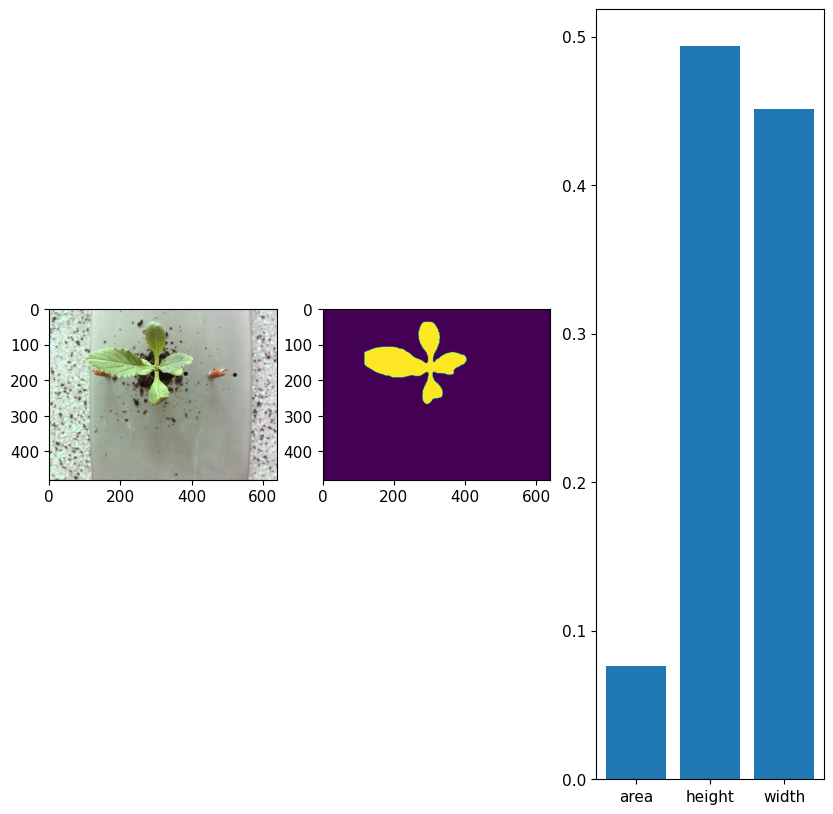

In [54]:
%matplotlib inline
import matplotlib.pyplot as plt
import cv2
import pyefd
from pyefd import elliptic_fourier_descriptors
import numpy as np


img = plt.imread(f"./data/gallery_17_03_23/vertical/rgb/seedlings_{10}_{2}.jpg")
depth = plt.imread(f"./data/gallery_17_03_23/vertical/depth/seedlings_{10}_{2}.jpg")
ret, thresh1 = cv2.threshold(depth, 120, 255, cv2.THRESH_BINARY)
result = cv2.bitwise_and(img,img,mask = thresh1)
img_pred = detector_v.predict(result)


contours, hierarchy = cv2.findContours(img_pred[0].mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
efd_features = efd_feature(contours, 10)


H, W, C = img.shape

x1,y1,x2,y2 = img_pred[0].bbox
fig, axs = plt.subplots(1, 3, figsize=(10, 10))

for idx, img_ in enumerate([img, img_pred[0].mask]):
    start_point = (int(x1), int(y1))
    end_point = (int(x2), int(y2))
    thickness = 2
    #img_ = cv2.rectangle(img_, start_point, end_point, color = (1,0,0), thickness=2)
    axs[idx].imshow(img_)


x = ["area", "height", "width"]
y = [img_pred[0].area/(H*W), (y2-y1)/H, (x2-x1)/W]
axs[2].bar(x, y)

plt.show()

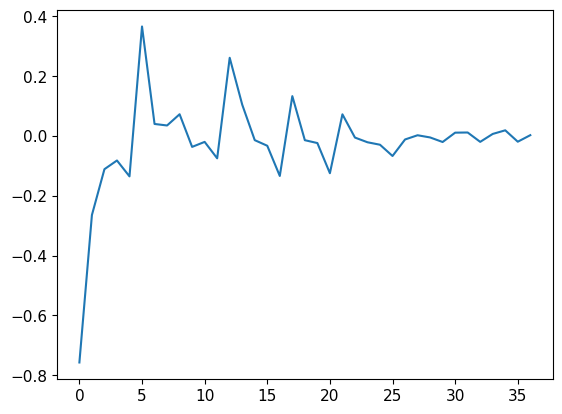

37


In [52]:
x = range(0, len(efd_features))
y = efd_features
plt.plot(x,y)
plt.show()

print(len(efd_features))

In [25]:
def efd_feature(contour, order):
    coeffs = []
    for cnt in contour:
        coeffs.append(elliptic_fourier_descriptors(np.squeeze(cnt), order=order, normalize=True))
    return coeffs[0].flatten()[3:]


def getDataVerticalView(path, df, show=False):
    col = range(1,7)
    row = range(1,13)

    height1 = []
    width1 = []
    area1 = []
    efd_features1 = []
    quality = []

    fig = plt.figure(figsize=(30, 30))
    
    idx = 0
    for i in col:
        for j in row:

            # read the corresponding seedling and apply yolov7 to obtain their mask, area, bbox
            img = plt.imread(f"{path}/vertical/rgb/seedlings_{j}_{i}.jpg")
            H, W, C = img.shape
            depth = plt.imread(f"{path}/vertical/depth/seedlings_{j}_{i}.jpg")
            ret, thresh1 = cv2.threshold(depth, 120, 255, cv2.THRESH_BINARY)
            result = cv2.bitwise_and(img,img,mask = thresh1)
            img_pred = detector_v.predict(result)

            
            # assign a quality according the long of the max leaf
            max_leaf = df[f"col{i}"][f"row{j}"]
            if max_leaf == -1:
                continue
            elif max_leaf > 80 :
                quality_status = 1
            else:
                quality_status = 0

            # verify if the prediction was succesful
            if img_pred is None or len(img_pred) == 0:
                continue

            if img_pred[0].area/(H*W) > 0.14:
                continue

            contours, hierarchy = cv2.findContours(img_pred[0].mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
            if len(contours)>=2 or contours is None:
                continue


            efd_features = efd_feature(contours, 10)
            #print(efd_features)

            # get the height, width, area. Normalize them and save it in a list
            x1,y1,x2,y2 = img_pred[0].bbox

            area_normalized = img_pred[0].area/(H*W)
            heigth_normalized = (y2-y1)/H
            width_normalized = (x2-x1)/W

            height1.append(heigth_normalized)
            width1.append(width_normalized)
            area1.append(area_normalized)
            efd_features1.append(efd_features)
            quality.append(quality_status)

            # to plot something
            idx = idx + 1

            if show != False:
                s = f"{max_leaf}mm"
                font = cv2.FONT_HERSHEY_SIMPLEX
                org = (200, 400)
                fontScale = 2
                color = (255, 0, 0)
                thickness = 2
                # img_pred[0].mask*255
                img = cv2.putText(img, s, org, font, 
                                                fontScale, color, thickness, cv2.LINE_AA)
                
                fig.add_subplot(12, 6, idx)
                plt.imshow(img)



    # build a dataframe with the data recolected
    dataset = {
        'quality': quality,
        'area': area1,
        'height': height1,
        'width': width1
    }
    print(len(efd_features))
    for idx, fourier_descriptor in enumerate(efd_features):
        dataset[f'fd_{idx}'] = fourier_descriptor

    return dataset

In [26]:
import matplotlib.pyplot as plt
import cv2
import pyefd
from pyefd import elliptic_fourier_descriptors
import numpy as np


df = pandas.read_csv('./data/gallery_17_03_23/Plantines_17_03_23 - Sheet1.csv')
data_17_03_23 = pandas.DataFrame(getDataVerticalView('./data/gallery_17_03_23', df))

df = pandas.read_csv('./data/gallery_24_03_23/Plantines_24_03_23 - Sheet1.csv')
data_24_03_23 = pandas.DataFrame(getDataVerticalView('./data/gallery_24_03_23',df))

df = pandas.read_csv('./data/gallery_03_03_23_tray1/Plantines_03_02_23_tray1 - Hoja 1.csv')
data_03_03_23_tray1 = pandas.DataFrame(getDataVerticalView('./data/gallery_03_03_23_tray1',df))

df = pandas.read_csv('./data/gallery_03_03_23_tray2/Plantines_03_02_23_tray2 - Hoja 1.csv')
data_03_03_23_tray2 = pandas.DataFrame(getDataVerticalView('./data/gallery_03_03_23_tray2',df))

df = pandas.read_csv('./data/gallery_03_03_23_tray3/Plantines_03_02_23_tray3 - Hoja 1.csv')
data_03_03_23_tray3 = pandas.DataFrame(getDataVerticalView('./data/gallery_03_03_23_tray3',df))

37
37
37
37
37


In [27]:
combined_df = pandas.concat(
    [data_03_03_23_tray1,
     data_03_03_23_tray2,
     data_03_03_23_tray3,
     data_17_03_23,
     data_24_03_23], axis=0)
    
combined_df.to_csv('combined_file_efd_added.csv', index=False)

# Training

In [17]:
import torch
import pandas as pd
from torch.utils.data import Dataset, DataLoader
import numpy as np
from sklearn.model_selection import train_test_split
import copy
from tqdm import tqdm

class seedlingFeaturesDataset(Dataset):
    def __init__(self, csv_file, root_dir):
            self.seedlingfeatures = pd.read_csv(csv_file)

    def __len__(self):
        return len(self.seedlingfeatures)
    

    def __getitem__(self, idx):

        if torch.is_tensor(idx):
            idx = idx.tolist()

        seedling_features = self.seedlingfeatures.iloc[idx, 1:7]
        quality = self.seedlingfeatures.iloc[idx, 0]

        seedling_features = np.array([seedling_features])
        quality = np.array([quality])

        sample = {'features':seedling_features, 'quality':quality}
        return sample
    
    def setSeedlingFeatures(self, idx):
        self.seedlingfeatures = self.seedlingfeatures.iloc[idx]
        return

    def get_subset(self, idx):
        dataset_copy = copy.copy(self)
        dataset_copy.setSeedlingFeatures(idx)
        return dataset_copy        


class DataloaderBuilder():
    def __init__(self, dataset):

        self.dataset = dataset
        self.len = len(dataset)
        self.range = range(0, self.len)

        self.input = None
        self.pred = None
    
    def get_train_test_set(self, test_size, batch_size=1):

        Xtrain_idx, Xtest_idx, Ytrain_idx, Ytest_idx = train_test_split(self.range, 
                                                        self.range, 
                                                        test_size=test_size, 
                                                        random_state=42,
                                                        shuffle=True)
        
        train_loader = DataLoader(self.dataset.get_subset(Xtrain_idx), batch_size=batch_size, shuffle=True)
        test_loader = DataLoader(self.dataset.get_subset(Xtest_idx), shuffle=True)
        return train_loader, test_loader

In [18]:
import torch.optim as optim
import torch
from torch import nn

def init_weights(m):
    if isinstance(m, nn.Linear):
        torch.nn.init.xavier_uniform(m.weight)
        m.bias.data.fill_(0.01)


class seedlingClassifier_MLP(nn.Module):
    def __init__(self,in_features):
        super().__init__()
        self.fc1 = nn.Linear(in_features, 32)
        self.fc2 = nn.Linear(32,64)
        self.fc3 = nn.Linear(64,32)
        self.fc4 = nn.Linear(32,1)
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.relu(self.fc1(x))
        x = self.relu(self.fc2(x))
        x = self.relu(self.fc3(x))
        x = torch.sigmoid(self.fc4(x))
        return x

In [4]:
def train(model, dataloader, optimizer, criterion):
    for batch_idx, data in enumerate(dataloader):

        inputs = data['features'].type(torch.FloatTensor).squeeze()
        targets = data['quality'].type(torch.FloatTensor)

        outputs = model(inputs)

        #print(torch.cat((outputs,targets), dim=1))
        loss = criterion(outputs, targets)
        #acc = (outputs.reshape(-1).detach().numpy().round() == targets).mean()
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

In [43]:
seedling_dataset = seedlingFeaturesDataset(csv_file='data/dataset_3weeks_H1W1A1_H2W2A2.csv', root_dir='./')
ds = DataloaderBuilder(seedling_dataset)
trainloader, testloader = ds.get_train_test_set(
    test_size=0.3,
    batch_size=10
)

# Hyperparameters of training
learning_rate = 0.01
epochs = 700
running_loss = 0.0

# MLP model applied to classify the seedlings
model = seedlingClassifier_MLP(6)
model.apply(init_weights)
optimizer = torch.optim.SGD(model.parameters(),lr=learning_rate)
criterion = nn.BCELoss()


model.train()
for epoch in range(800):
    n_samples = 0
    accuracy = 0

    for idx,sample in enumerate(trainloader):
        inputs = sample['features'].type(torch.FloatTensor).squeeze()
        targets = sample['quality'].type(torch.FloatTensor)

        outputs = model(inputs)
        n_samples_,_ = outputs.shape
        n_samples += n_samples_

        accuracy += torch.sum(torch.logical_not(torch.logical_xor(targets > 0.5, outputs > 0.5)))

        loss = criterion(outputs, targets)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    
    if epoch % 50 == 0:
        print("Accuracy:",(accuracy/n_samples).item())

/tmp/ipykernel_6768/2806408524.py:7: UserWarning: nn.init.xavier_uniform is now deprecated in favor of nn.init.xavier_uniform_.
  torch.nn.init.xavier_uniform(m.weight)


Accuracy: 0.6644295454025269
Accuracy: 0.6644295454025269
Accuracy: 0.6644295454025269
Accuracy: 0.7651006579399109
Accuracy: 0.818791925907135
Accuracy: 0.8523489832878113
Accuracy: 0.8456375598907471
Accuracy: 0.8456375598907471
Accuracy: 0.8456375598907471
Accuracy: 0.8523489832878113
Accuracy: 0.8456375598907471
Accuracy: 0.8456375598907471
Accuracy: 0.8389261960983276
Accuracy: 0.8724831938743591
Accuracy: 0.8389261960983276
Accuracy: 0.8523489832878113


In [42]:
# threshold of 50% gives the maximum precisionEntonces puedo concluir que el filtro de Kalman es un algoritmo que se usa en AI pero no es un algoritmo de AI
threshold = 0.5
correct = 0
fail = 0

# Testing on testset
with torch.no_grad():
    model.eval()    
    for data in testloader:
        input = data['features'].type(torch.FloatTensor)[0,:,:]
        #input2 = data['fourier_descriptors'].type(torch.FloatTensor)
        target = data['quality'].type(torch.FloatTensor)
        #print(input1.shape,input2.shape)
        output = model(input)
        #print('target:', target, '| output:', output)

        if output.item() > threshold:
            pred = 1
        else:
            pred = 0
        
        if pred == target:
            correct += 1
        else:
            fail += 1

print(correct/(correct+fail))

0.8289473684210527


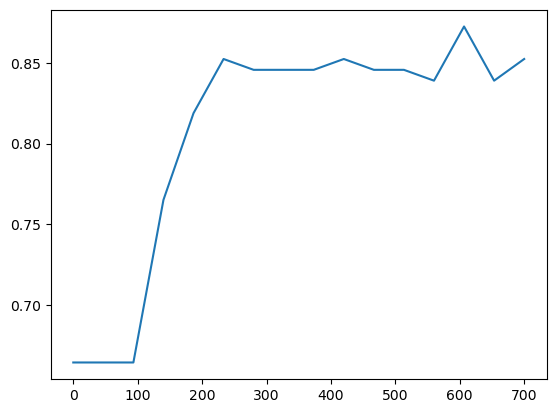

In [7]:
y = [0.6644295454025269,
0.6644295454025269,
0.6644295454025269,
0.7651006579399109,
0.818791925907135,
0.8523489832878113,
0.8456375598907471,
0.8456375598907471,
0.8456375598907471,
0.8523489832878113,
0.8456375598907471,
0.8456375598907471,
0.8389261960983276,
0.8724831938743591,
0.8389261960983276,
0.8523489832878113]

import numpy as np

x = np.linspace(start=0, stop=700,num=len(y))


import matplotlib.pyplot as plt

plt.plot(x,y)